<a href="https://colab.research.google.com/github/bwakyaya/dva-unathorized-access-analysis/blob/main/DataVisualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd          # For data handling
import numpy as np           # For numerical operations
import matplotlib.pyplot as plt  # For static visualizations
import seaborn as sns        # For advanced plots (like correlation heatmaps)
import plotly.express as px  # For interactive visualizations

import zipfile               # For unzipping files
import os                    # For file path operations
import io                    # For reading files from zip
import warnings              # To suppress warnings
from google.colab import drive

In [ ]:
# Load the CSV using pandas
drive.mount('/content/drive')

df = pd.read_csv("/content/drive/My Drive/cleaned_ids2018_sampled.csv")

# Check column names
df.columns

num_records = len(df)
print(f"Total number of records: {num_records}")
# Show first few rows to confirm it's loaded
df.head()



NameError: name 'drive' is not defined

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# 2. Identify the first column (it’s currently unnamed)
first_col = df.columns[0]
print("Original first column name:", first_col)

# 3. Rename it to 'FlowID'
df = df.rename(columns={ first_col: 'FlowID' })

# 4. Verify the change
print(df.columns.tolist()[:10])  # shows first 10 column names
print(df['FlowID'].head())


Original first column name: Unnamed: 0
['FlowID', 'Dst Port', 'Protocol', 'Flow Duration', 'Tot Fwd Pkts', 'Tot Bwd Pkts', 'TotLen Fwd Pkts', 'TotLen Bwd Pkts', 'Fwd Pkt Len Max', 'Fwd Pkt Len Min']
0    146275
1    512109
2    807703
3    491912
4    858679
Name: FlowID, dtype: int64


In [ ]:
# Show first few rows to confirm it's loaded
df.head()

,FlowID,Dst Port,Protocol,Flow Duration,Tot Fwd Pkts,Tot Bwd Pkts,TotLen Fwd Pkts,TotLen Bwd Pkts,Fwd Pkt Len Max,Fwd Pkt Len Min,...,Fwd Seg Size Min,Active Mean,Active Std,Active Max,Active Min,Idle Mean,Idle Std,Idle Max,Idle Min,Label
0,146275,3389,6,5206015,9,11,1213,1948,661,0,...,20,0.000000,0.000000,0,0,0.000000e+00,0.000000e+00,0,0,1
1,512109,443,6,60991608,14,14,1211,3396,875,0,...,20,116504.666667,117401.762867,356150,68519,1.000239e+07,1.665183e+04,10009249,9968397,1
2,807703,53,17,27292,1,1,45,163,45,45,...,8,0.000000,0.000000,0,0,0.000000e+00,0.000000e+00,0,0,1
3,491912,443,6,70343424,17,20,1118,5653,258,0,...,20,527683.500000,386311.526445,800847,254520,3.457024e+07,3.406089e+07,58654921,10485549,1
4,858679,53,17,137267,2,2,94,214,47,47,...,8,0.000000,0.000000,0,0,0.000000e+00,0.000000e+00,0,0,1


In [ ]:
#Check dataset shape and types
df.shape  # rows and columns
df.info()  # data types and nulls

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1252846 entries, 0 to 1252845
Data columns (total 79 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   FlowID             1252846 non-null  int64  
 1   Dst Port           1252846 non-null  int64  
 2   Protocol           1252846 non-null  int64  
 3   Flow Duration      1252846 non-null  int64  
 4   Tot Fwd Pkts       1252846 non-null  int64  
 5   Tot Bwd Pkts       1252846 non-null  int64  
 6   TotLen Fwd Pkts    1252846 non-null  int64  
 7   TotLen Bwd Pkts    1252846 non-null  int64  
 8   Fwd Pkt Len Max    1252846 non-null  int64  
 9   Fwd Pkt Len Min    1252846 non-null  int64  
 10  Fwd Pkt Len Mean   1252846 non-null  float64
 11  Fwd Pkt Len Std    1252846 non-null  float64
 12  Bwd Pkt Len Max    1252846 non-null  int64  
 13  Bwd Pkt Len Min    1252846 non-null  int64  
 14  Bwd Pkt Len Mean   1252846 non-null  float64
 15  Bwd Pkt Len Std    1252846 non-n

In [ ]:
#Missing values check, 0 = no missing values and 1 = missing value
df.isnull().sum()

,0
FlowID,0
Dst Port,0
Protocol,0
Flow Duration,0
Tot Fwd Pkts,0
...,...
Idle Mean,0
Idle Std,0
Idle Max,0
Idle Min,0


In [ ]:
#Check how many rows have missing data
df.isnull().any(axis=1).sum()

np.int64(0)

In [ ]:
#Drop the row since 1 row has negligible effect on a dataset with over a million rows.
df = df.dropna()

In [ ]:
#This was to verify if the empty row was dropped
df.isnull().any(axis=1).sum()

np.int64(0)

In [ ]:
#applied a mapping to translate the numerical labels in the 'Label' column to their corresponding attack types
label_map = {
    1.0: "Benign",
    2.0: "DoS Hulk",
    3.0: "PortScan",
    4.0: "DDoS",
    5.0: "DoS GoldenEye",
    6.0: "FTP-Patator",
    7.0: "SSH-Patator",
    8.0: "Web Attack – Brute Force",
    9.0: "Web Attack – XSS",
    10.0: "Infiltration",
    11.0: "Bot"
}

df["Attack Type"] = df["Label"].map(label_map)

# Create a summary table with Label Code, Attack Type, and Count
label_counts = df["Label"].value_counts().sort_index()
label_df = pd.DataFrame({
    "Label Code": label_counts.index,
    "Attack Type": [label_map[label] for label in label_counts.index],
    "Count": label_counts.values
})

print(label_df)

    Label Code               Attack Type   Count
0            1                    Benign  971016
1            2                  DoS Hulk   38703
2            3                  PortScan   37323
3            4                      DDoS  137185
4            5             DoS GoldenEye   57507
5            6               FTP-Patator    8377
6            7               SSH-Patator    2234
7            8  Web Attack – Brute Force     332
8            9          Web Attack – XSS     103
9           10              Infiltration      55
10          11                       Bot      11


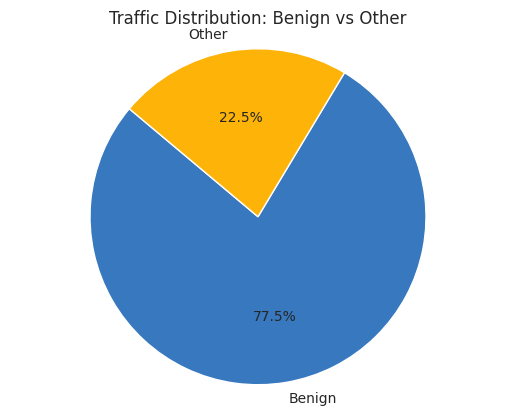

In [ ]:
# Total flows
total_flows = len(df)

# Benign flows
benign_flows = df[df['Label'] == 1].shape[0]

import matplotlib.pyplot as plt

# Other (non-benign) flows
non_benign_flows = total_flows - benign_flows

# Percentage
benign_percentage = (benign_flows / total_flows) * 100
non_benign_percentage = (non_benign_flows / total_flows) * 100

labels = ['Benign', 'Other']
sizes = [benign_percentage, non_benign_percentage]
colors = sns.xkcd_palette(['windows blue', 'amber'])

plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=140)
plt.title("Traffic Distribution: Benign vs Other")
plt.axis('equal')  # Equal aspect ratio ensures pie is drawn as a circle.
plt.show()

Question 1: How is the dataset split between benign and attack traffic?

We begin by examining the general composition of traffic in our dataset.

Chart: Pie Chart – Benign vs. Malicious **Traffic**

Insight: This gives us a quick snapshot of dataset balance, revealing whether malicious traffic dominates, or if we're dealing with a subtle threat landscape.

In [ ]:
#bar graph was plotted to show distribution of attack types
plt.figure(figsize=(12, 6))
sns.countplot(data=df, y="Attack Type", order=df["Attack Type"].value_counts().index, palette="viridis")
plt.title("Distribution of Attack Types", fontsize=16)
plt.xlabel("Number of Records")
plt.ylabel("Attack Type")
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

Question 2: What Types of Attacks Are We Dealing With?

We dive into the types of attacks observed to understand threat diversity.

Chart: Bar Chart – Distribution of Attack Types

Insight: Highlights which threats are most prevalent, guiding where to focus mitigation strategies.



---



/usr/local/lib/python3.11/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning:

invalid value encountered in log1p

<ipython-input-93-40fee232f25b>:32: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




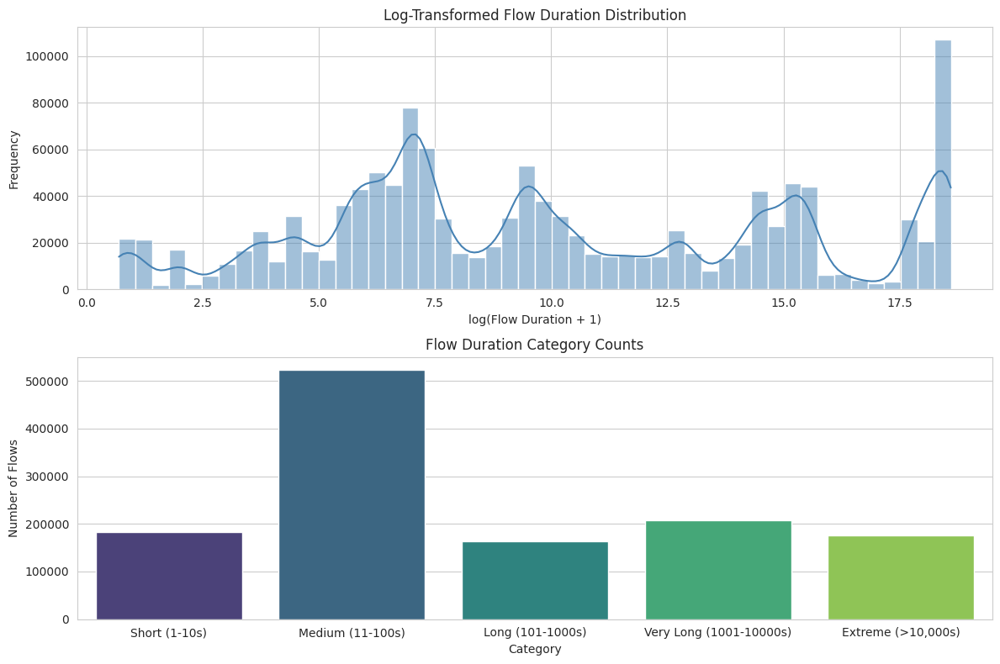

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Apply log1p transform to Flow Duration
df['log_flow_duration'] = np.log1p(df['Flow Duration'])

# Define bins and human-friendly labels
bins = [0, 5, 10, 13, 16, np.inf]
labels = ['Short (1-10s)', 'Medium (11-100s)', 'Long (101-1000s)', 'Very Long (1001-10000s)', 'Extreme (>10,000s)']

# Categorize the flow durations based on the bins
df['Flow Duration Category'] = pd.cut(df['log_flow_duration'], bins=bins, labels=labels)

# Count how many flows fall into each category
category_counts = df['Flow Duration Category'].value_counts().sort_index()

#Plotting
plt.figure(figsize=(12, 8))
sns.set_style("whitegrid")

# Histogram of log-transformed flow durations
plt.subplot(2, 1, 1)
sns.histplot(df['log_flow_duration'], bins=50, kde=True, color='steelblue')
plt.title('Log-Transformed Flow Duration Distribution')
plt.xlabel('log(Flow Duration + 1)')
plt.ylabel('Frequency')

# Bar plot of Flow Duration Category Counts
plt.subplot(2, 1, 2)
sns.barplot(x=category_counts.index, y=category_counts.values, palette="viridis")
plt.title('Flow Duration Category Counts')
plt.xlabel('Category')
plt.ylabel('Number of Flows')

plt.tight_layout()
plt.show()


Question 3: How Long Do These Attacks Last?

We explore the duration of attack flows to assess severity and stealth.

Charts:

Log-transformed Flow Duration Distribution – Normalizes duration scale.

Flow Duration by Attack Type (Box Plot) – Compares typical durations across attack categories.

Flow Duration Categories (Count Plot) – Segments flows into quick vs long-lived.

Insight: Helps identify persistent threats and potential DoS or stealth behavior.


Based on the results above for Data Distribution;



1.   Most traffic is tiny. Almost every flow lasts only a shorttime, carries only a few packets, and moves very little data. That’s your everyday, harmless browsing and emailing.

2.   A few flows are huge. Those few spikes are the big file dumps, denial-of-service blasts, or sneaky long-running intrusions. They’re rare but important to spot.


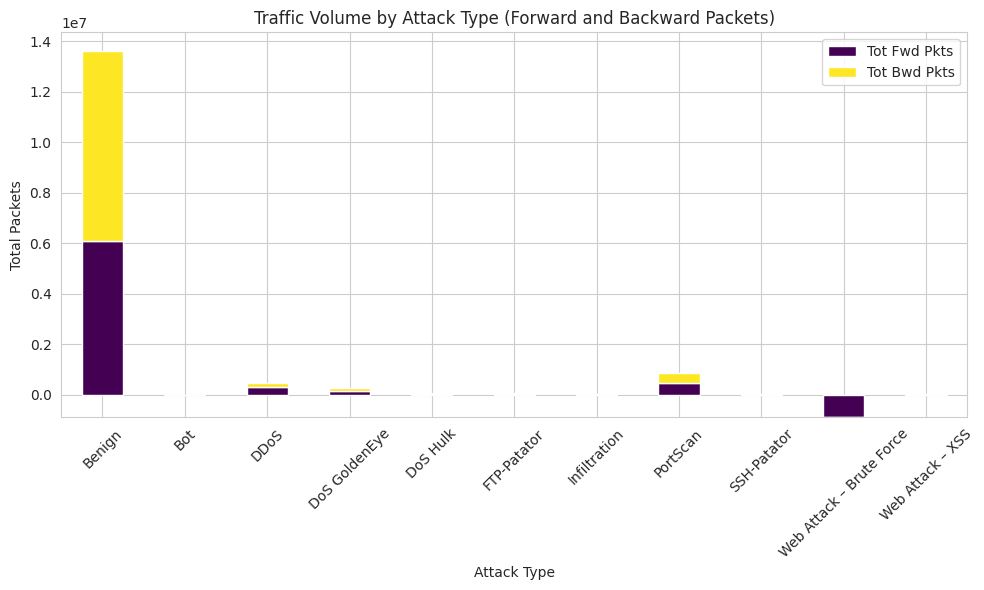

In [ ]:
#Traffic Volume by Attack Type
# Group by Attack Type and sum traffic
traffic_by_attack = df.groupby('Attack Type')[['Tot Fwd Pkts', 'Tot Bwd Pkts']].sum()

traffic_by_attack.plot(
    kind='bar',
    stacked=True,
    figsize=(10, 6),
    colormap='viridis'
)
plt.title('Traffic Volume by Attack Type (Forward and Backward Packets)')
plt.xlabel('Attack Type')
plt.ylabel('Total Packets')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


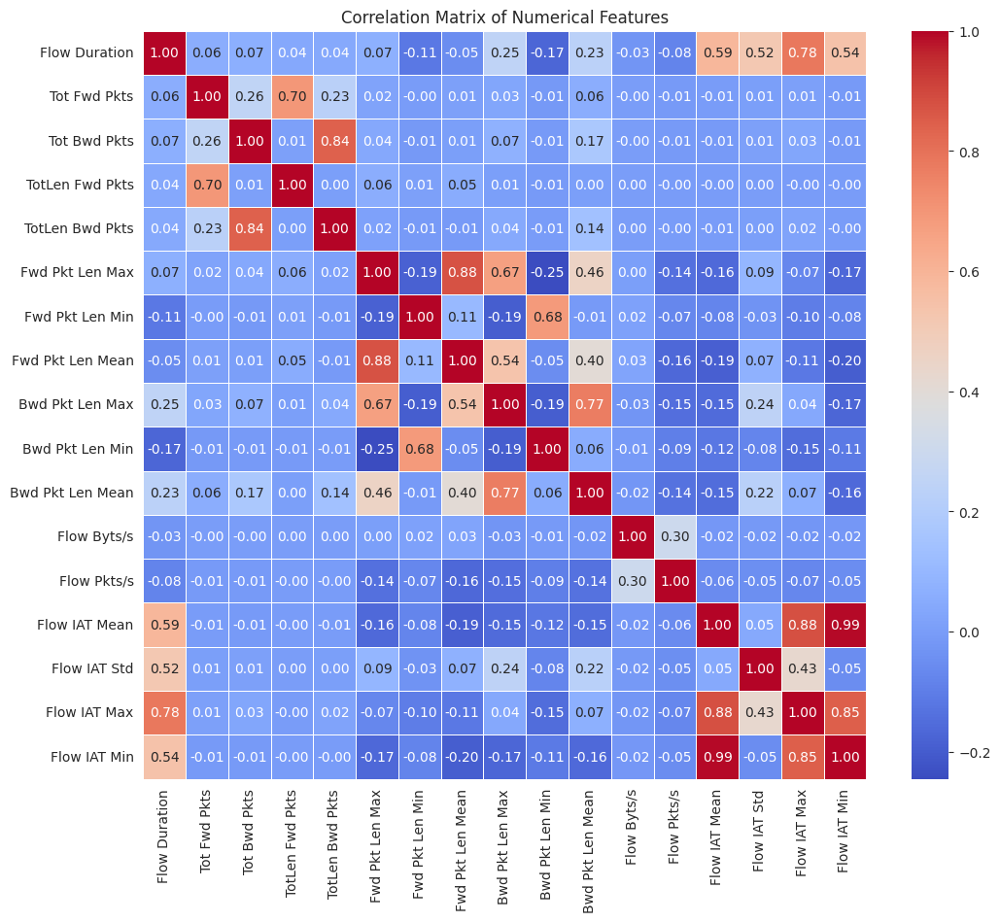

In [ ]:
# Calculate the correlation matrix, A heatmap will allow us to visually identify strong relationships between variables.
correlation_matrix = df[numerical_columns].corr()

# Plotting the heatmap for correlations
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix of Numerical Features')
plt.show()

#Highly correlated variables can help us understand potential cause-effect relationships and multicollinearity.


Question: Which features are correlated?

Why it matters: Guides feature selection for modeling, and surfaces hidden patterns.

“Tot Fwd Pkts” and “TotLen Fwd Pkts” have a correlation of 0.70, showing that as the total number of forward packets increases, the total length of those packets also tends to increase.

“Tot Bwd Pkts” and “TotLen Bwd Pkts” have a very high correlation of 0.84, meaning the same relationship exists for backward packets.

Features related to packet lengths within the same direction (like “Fwd Pkt Len Max” and “Fwd Pkt Len Mean” at 0.88, or “Bwd Pkt Len Max” and “Bwd Pkt Len Mean” at 0.77) are strongly correlated, so higher maximum lengths often mean higher average lengths.

Section 3: Static Visualization Analysis


1.   Most Targeted Destination Ports
2.   Flow Duration by Attack Type
3.   Protocol Usage Across Attack Types
4.   Attack Type vs. Destination Port
5.   Average Packet Size by Attack Type
6.   Flags Used in Attacks
7.   Traffic Volume by Attack Type




<ipython-input-46-0d249cc2b15b>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




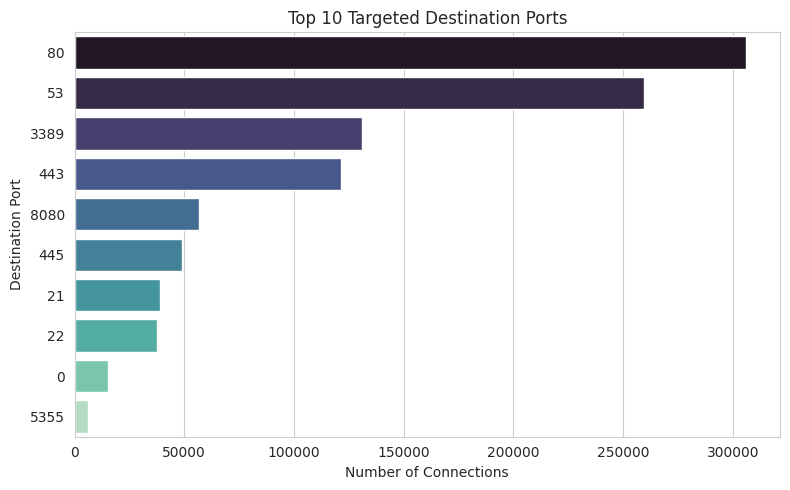

In [ ]:
# Most Targeted Destination Ports
# Bar Chart of the top 10 most frequent destination ports.
import matplotlib.pyplot as plt
import seaborn as sns

# Count connections per port
top_ports = df['Dst Port'].value_counts().head(10)

plt.figure(figsize=(8, 5))
sns.barplot(
    x=top_ports.values,
    y=top_ports.index.astype(str),
    palette='mako'
)
plt.title('Top 10 Targeted Destination Ports')
plt.xlabel('Number of Connections')
plt.ylabel('Destination Port')
plt.tight_layout()
plt.show()




---



<ipython-input-47-a200a9159c37>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




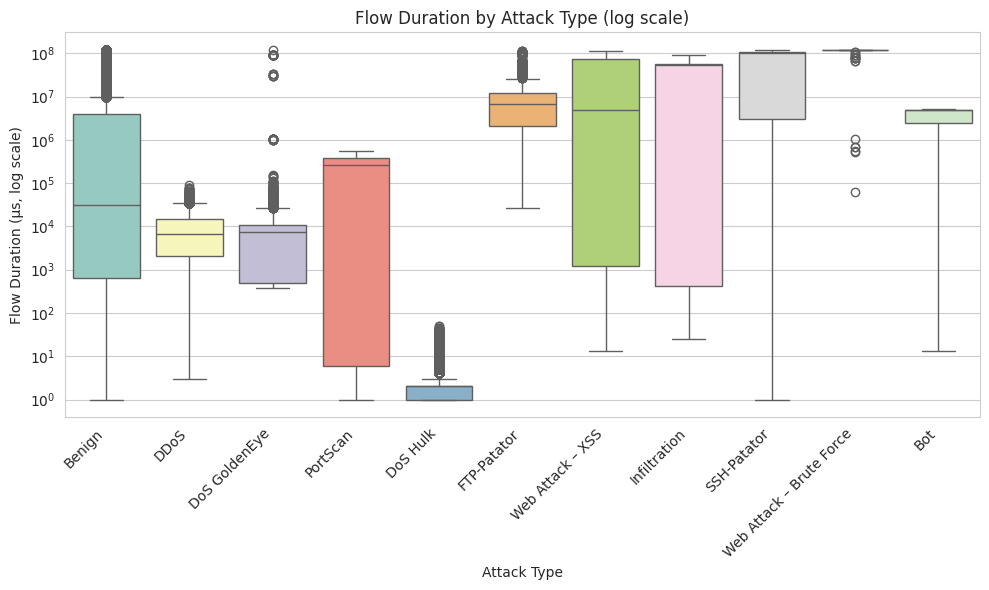

In [ ]:
# Flow Duration by Attack Type
# Box Plot (with log scale on Y) showing how flow durations differ across attack types

plt.figure(figsize=(10, 6))
sns.boxplot(
    x='Attack Type',
    y='Flow Duration',
    data=df,
    palette='Set3'
)
plt.yscale('log')
plt.xticks(rotation=45, ha='right')
plt.title('Flow Duration by Attack Type (log scale)')
plt.ylabel('Flow Duration (µs, log scale)')
plt.xlabel('Attack Type')
plt.tight_layout()
plt.show()




---





---



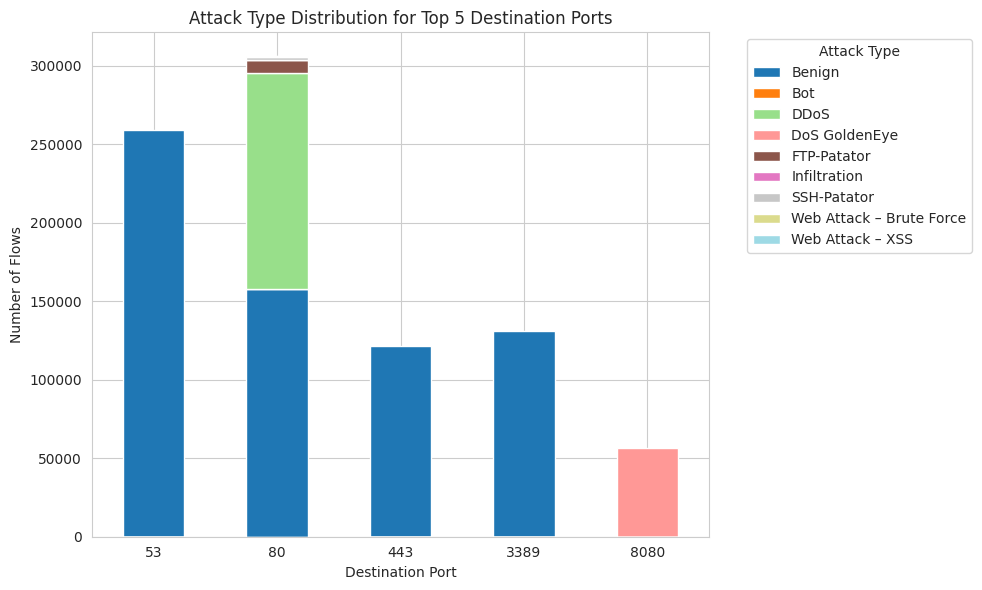

In [ ]:
# Attack Type vs. Destination Port
# Stacked Bar Chart showing, for the top 5 ports, how many flows of each attack type go to each port.
# Prepare a pivot for top 5 ports
top5 = df['Dst Port'].value_counts().head(5).index
pivot = (df[df['Dst Port'].isin(top5)]
         .groupby(['Dst Port','Attack Type'])
         .size().unstack(fill_value=0))

pivot.plot(
    kind='bar',
    stacked=True,
    figsize=(10,6),
    colormap='tab20'
)
plt.title('Attack Type Distribution for Top 5 Destination Ports')
plt.xlabel('Destination Port')
plt.ylabel('Number of Flows')
plt.xticks(rotation=0)
plt.legend(title='Attack Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


Question: Which attacks target which ports?

Why it matters: Connects attack type to services.

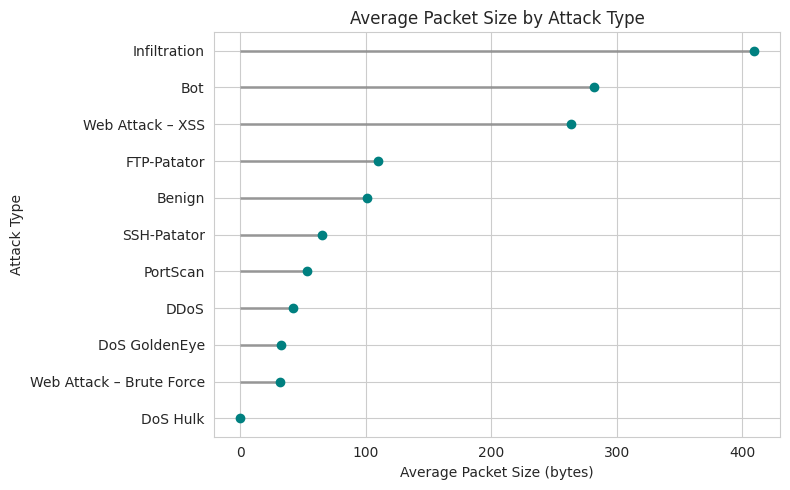

In [ ]:
# Average Packet Size by Attack Type
# Lollipop Chart of the average Pkt Size Avg per attack type.
# Calculate averages
avg_pkt = df.groupby('Attack Type')['Pkt Size Avg'].mean().sort_values()

plt.figure(figsize=(8, 5))
plt.hlines(
    y=avg_pkt.index,
    xmin=0,
    xmax=avg_pkt.values,
    color='gray',
    alpha=0.7,
    linewidth=2
)
plt.plot(
    avg_pkt.values,
    avg_pkt.index,
    'o',
    color='teal'
)
plt.title('Average Packet Size by Attack Type')
plt.xlabel('Average Packet Size (bytes)')
plt.ylabel('Attack Type')
plt.tight_layout()
plt.show()


Question: Which attacks send the biggest or smallest packets on average?

Why it matters: Helps distinguish attack styles.

<ipython-input-51-a251cf686da3>:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




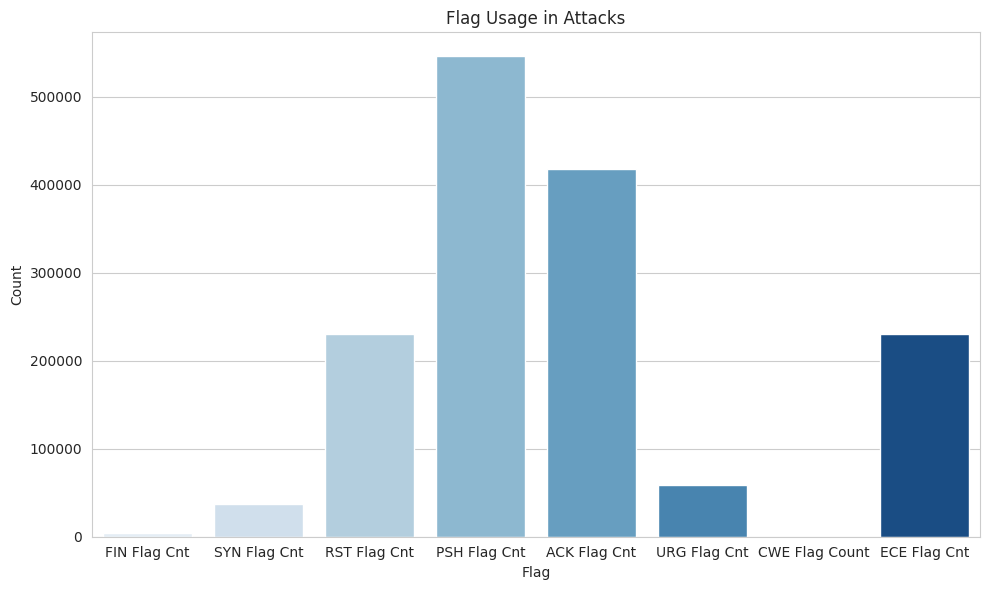

In [ ]:
#Flags Used in Attacks
# Count the usage of each flag
flag_counts = df[['FIN Flag Cnt', 'SYN Flag Cnt', 'RST Flag Cnt', 'PSH Flag Cnt',
                  'ACK Flag Cnt', 'URG Flag Cnt', 'CWE Flag Count', 'ECE Flag Cnt']].sum()

plt.figure(figsize=(10, 6))
sns.barplot(x=flag_counts.index, y=flag_counts.values, palette='Blues')
plt.title('Flag Usage in Attacks')
plt.xlabel('Flag')
plt.ylabel('Count')
plt.tight_layout()
plt.show()



Flags Used in Attacks

Bar Chart to visualize the frequency of different flags used in packets. This can help identify attack characteristics based on the flags set in the packets.

Traffic Volume by Attack Type

Stacked Bar Chart showing the total number of packets or bytes per attack type. This will allow you to see which attacks generate the most traffic.

Section 4: Interactive Visualization Dashboard

This section will focus on interactive visualizations that allow deeper exploration and filtering of the data. These dashboards enable users to interact with the data to uncover more granular insights.

In [ ]:
fig = px.box(df, x='Attack Type', y='Pkt Len Mean', color='Attack Type',
             title='Packet Length Distribution by Attack Type')
fig.show()


Question: How do packet sizes vary per attack type?

Why it matters: Could indicate flooding (large packets) or probing (tiny packets).

In [ ]:
import pandas as pd
import plotly.graph_objects as go

# Filter top 10 destination ports
top_ports = df['Dst Port'].value_counts().head(10).index
filtered_df = df[df['Dst Port'].isin(top_ports)]

# Ensure Attack Type column exists
if 'Attack Type' not in filtered_df.columns:
    raise ValueError("Column 'Attack Type' not found in your DataFrame")

# Replace NaNs in 'Attack Type' for safe mapping
filtered_df['Attack Type'] = filtered_df['Attack Type'].fillna('Other')

# Group data by port and attack type
grouped = filtered_df.groupby(['Dst Port', 'Attack Type']).size().reset_index(name='count')
grouped['Dst Port'] = grouped['Dst Port'].astype(str)

# Create label list and mapping
ports = grouped['Dst Port'].unique().tolist()
attacks = grouped['Attack Type'].unique().tolist()
labels = ports + attacks
label_map = {label: i for i, label in enumerate(labels)}

# Color palette (you can customize further)
color_palette = {
    'DDoS': 'rgba(255,0,0,0.6)',
    'PortScan': 'rgba(255,165,0,0.6)',
    'BruteForce': 'rgba(0,128,0,0.6)',
    'Infiltration': 'rgba(0,0,255,0.6)',
    'Bot': 'rgba(75,0,130,0.6)',
    'Web Attack': 'rgba(255,20,147,0.6)',
    'Heartbleed': 'rgba(128,0,0,0.6)',
    'SQL Injection': 'rgba(138,43,226,0.6)',
    'FTP-Patator': 'rgba(0,206,209,0.6)',
    'SSH-Patator': 'rgba(255,140,0,0.6)',
    'Other': 'rgba(169,169,169,0.6)'
}

# Map sources, targets, values
sources = grouped['Dst Port'].map(label_map)
targets = grouped['Attack Type'].map(label_map)
values = grouped['count']
link_colors = grouped['Attack Type'].map(lambda x: color_palette.get(x, 'rgba(100,100,100,0.6)')).tolist()

# Create Sankey Diagram
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=labels,
        color="lightblue"
    ),
    link=dict(
        source=sources,
        target=targets,
        value=values,
        color=link_colors
    )
)])

fig.update_layout(title_text="Sankey Diagram: Top 10 Targeted Ports → Attack Types", font_size=12)
fig.show()


<ipython-input-62-30e0357125d0>:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Question:

Which attack types are associated with the most frequently targeted destination ports?

Why it matters:

This diagram uncovers relationships between specific attack types and the ports they target, which can:

Help network defenders monitor or block critical ports.

Reveal attacker preferences and strategies (e.g., brute force on port 22 for SSH, or DDoS on port 80 for HTTP).

Suggest which services/systems are most at risk.

<ipython-input-7-00e7ba3be0a8>:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(10, 'Count'))


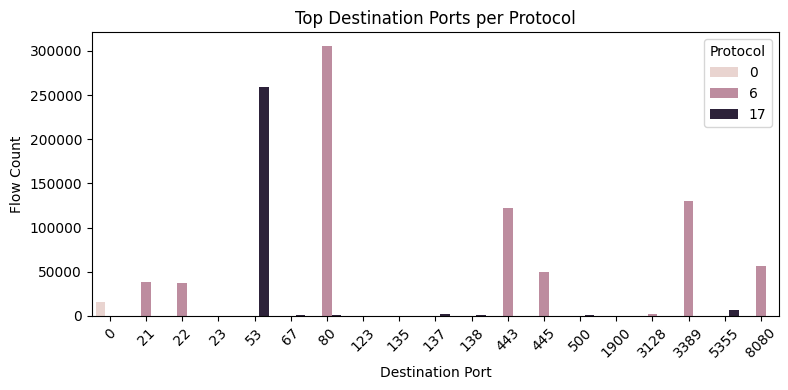

In [ ]:
# Group and count how many times each Dst Port is used per Protocol
port_usage = df.groupby(['Protocol', 'Dst Port']).size().reset_index(name='Count')

# Sort to make it cleaner
port_usage = port_usage.sort_values(by='Count', ascending=False)
top_ports_per_protocol = (
    port_usage.groupby('Protocol')
    .apply(lambda x: x.nlargest(10, 'Count'))
    .reset_index(drop=True)
)

plt.figure(figsize=(8, 4))
sns.barplot(data=top_ports_per_protocol, x='Dst Port', y='Count', hue='Protocol')
plt.title("Top Destination Ports per Protocol")
plt.xlabel("Destination Port")
plt.ylabel("Flow Count")
plt.legend(title="Protocol")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()